In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Segmentasi data

In [ ]:
pip install noisereduce

In [ ]:
import os
import librosa
import soundfile as sf  # Untuk menyimpan file .wav terpisah
import noisereduce as nr  # Untuk mengurangi noise

# direktori tempat file WAV
base_dir = '/content/drive/MyDrive/TUBES DL/Persiapan Data/Dataset/wav'

# direktori output untuk file yang dibagi
output_dir = '/content/drive/MyDrive/TUBES DL/Persiapan Data/Dataset/splitdata_5detik'

# Memastikan direktori output ada
os.makedirs(output_dir, exist_ok=True)

# Dapatkan daftar file .wav yang ada di dalam direktori
all_files = [f for f in os.listdir(base_dir) if f.endswith('.wav')]

# Menampilkan beberapa file yang ditemukan
print(f"File WAV yang ditemukan: {all_files}")

# Fungsi untuk membagi file menjadi segmen 5 detik dan mengolah audio
def split_into_segments(file):
    # Muat audio menggunakan librosa
    audio_path = os.path.join(base_dir, file)
    y, sr = librosa.load(audio_path, sr=None)  # sr=None untuk mempertahankan sample rate asli

    # Mengurangi noise dengan noisereduce
    y = nr.reduce_noise(y=y, sr=sr)

    # Meningkatkan volume (desibel) audio dengan penguatan sinyal
    gain_factor = 2.0   # meningkatkan volume sebanyak 2x
    y = y * gain_factor  # Perbesar sinyalnya

    # MengHitung total durasi audio
    total_duration = len(y) / sr  # dalam detik
    segment_duration = 5  # durasi per segmen dalam detik

    # Hitung jumlah segmen berdasarkan durasi 5 detik
    num_segments = int(total_duration // segment_duration)

    # Menyaring segmen agar 5 detik
    segment_samples = int(segment_duration * sr)  # panjang segmen dalam sampel
    segments = [y[i:i + segment_samples] for i in range(0, num_segments * segment_samples, segment_samples)]

    return segments, sr  # Mengembalikan segmen dan sample rate (sr)

# Mengelompokkan file berdasarkan kelas
classes = {}

# Mengelompokkan file berdasarkan nama kelas
for file in all_files:
    class_name = file.split('_')[0]
    if class_name not in classes:
        classes[class_name] = []
    classes[class_name].append(file)

# Menyimpan segmen-segmen dari setiap kelas
class_segments = {}

# Membagi setiap file ke dalam segmen 5 detik
for class_name, files in classes.items():
    segments_per_class = []
    for file in files:
        segments, sr = split_into_segments(file)  # Mendapatkan segmen dan sample rate
        segments_per_class.extend(segments)  # Gabungkan semua segmen dari file-file kelas ini

    class_segments[class_name] = (segments_per_class, sr)  # Menyimpan segmen dan sr

# Menyimpan segmen-segmen tanpa membatasi jumlahnya
os.makedirs(output_dir, exist_ok=True)

# Menyimpan segmen yang telah dipilih
for class_name, (segments, sr) in class_segments.items():
    for i, segment in enumerate(segments):
        # Menyimpan segmen sebagai file WAV
        segment_filename = f"{class_name}_{i+1}.wav"  # Penamaan file urut berdasarkan kelas
        segment_path = os.path.join(output_dir, segment_filename)
        sf.write(segment_path, segment, sr)  # Menyimpan segmen sebagai file .wav
        print(f"Segmen {i+1} dari kelas {class_name} disimpan sebagai {segment_filename}")

print("Proses selesai!")

File WAV yang ditemukan: ['Pool_1.wav', 'Pool_2.wav', 'PepperFrog_1.wav', 'Pool_3.wav', 'Pool_4.wav', 'PepperFrog_2.wav', 'Pool_5.wav', 'PepperFrog_3.wav', 'Pool_6.wav', 'Pool_7.wav', 'PepperFrog_4.wav', 'Pool_8.wav', 'PepperFrog_5.wav', 'Pool_9.wav', 'PepperFrog_6.wav', 'Pool_10.wav', 'PepperFrog_7.wav', 'PepperFrog_8.wav', 'Boana_1.wav', 'PepperFrog_9.wav', 'Boana_2.wav', 'PepperFrog_10.wav', 'Boana_3.wav', 'Boana_4.wav', 'Boana_5.wav', 'Boana_6.wav', 'Boana_7.wav', 'Boana_8.wav', 'Boana_9.wav', 'Boana_10.wav', 'South_1.wav', 'South_2.wav', 'South_3.wav', 'South_4.wav', 'South_5.wav', 'South_6.wav', 'South_7.wav', 'South_8.wav', 'South_9.wav', 'South_10.wav', 'Dendropsophus_1.wav', 'Dendropsophus_2.wav', 'Dendropsophus_3.wav', 'Dendropsophus_4.wav', 'Dendropsophus_5.wav', 'Dendropsophus_6.wav', 'Dendropsophus_7.wav', 'Leptodactylus_1.wav', 'Leptodactylus_2.wav', 'Leptodactylus_3.wav', 'Leptodactylus_4.wav', 'Leptodactylus_5.wav', 'Leptodactylus_6.wav', 'Leptodactylus_7.wav', 'Leptoda

In [ ]:
import os

# Direktori tempat file WAV yang telah diproses berada
base_dir = '/content/drive/MyDrive/TUBES DL/Persiapan Data/Dataset/splitdata_5detik'

# Dapatkan daftar file .wav dalam direktori
all_files = [f for f in os.listdir(base_dir) if f.endswith('.wav')]

# Memisahkan nama kelas berdasarkan file
classes = {}

# Hitung jumlah file per kelas
for file in all_files:
    # Ambil bagian sebelum angka pertama sebagai nama kelas (misal 'South')
    class_name = file.split('_')[0]
    if class_name not in classes:
        classes[class_name] = 0
    classes[class_name] += 1

# Menampilkan jumlah file per kelas
for class_name, count in classes.items():
    print(f"Kelas '{class_name}' memiliki {count} file.")

Kelas 'Pool' memiliki 133 file.
Kelas 'PepperFrog' memiliki 206 file.
Kelas 'Boana' memiliki 172 file.
Kelas 'South' memiliki 93 file.
Kelas 'Dendropsophus' memiliki 132 file.
Kelas 'Leptodactylus' memiliki 93 file.
Kelas 'Rana' memiliki 426 file.
Kelas 'Rhinella' memiliki 139 file.
Kelas 'Scinax' memiliki 133 file.


## Ekstraksi MFCC

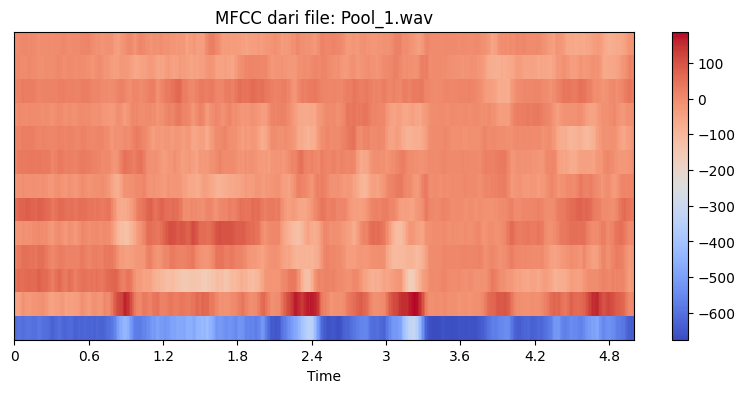

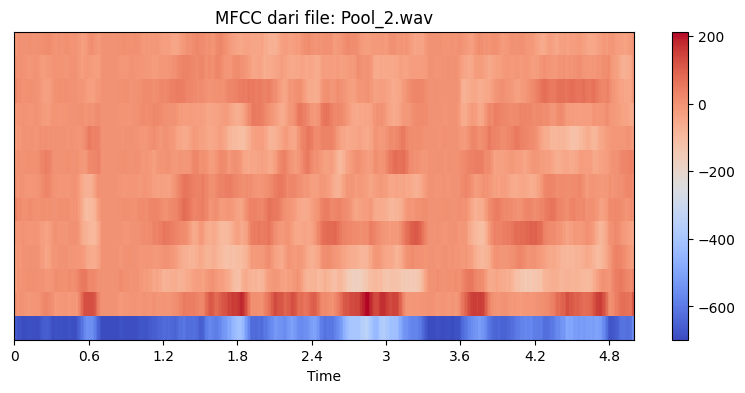

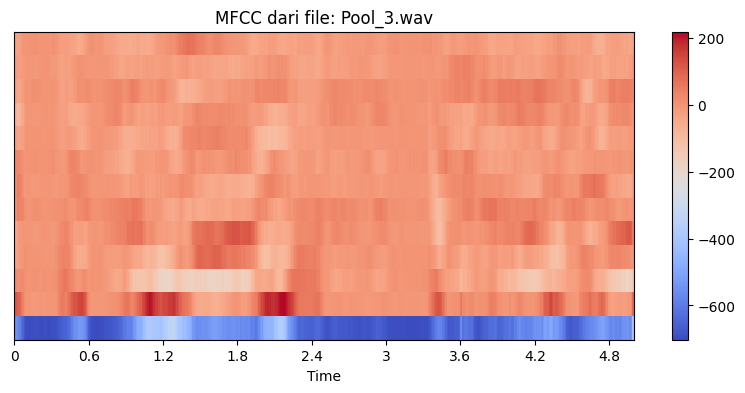

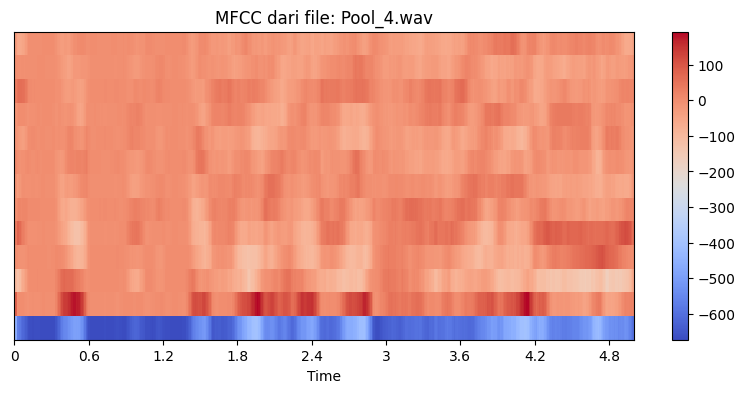

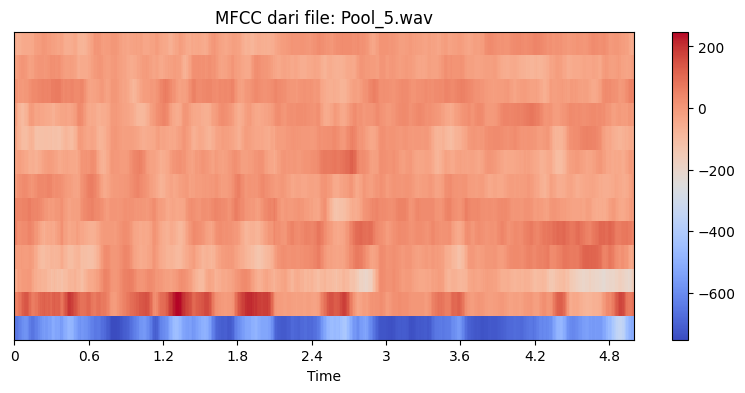

...

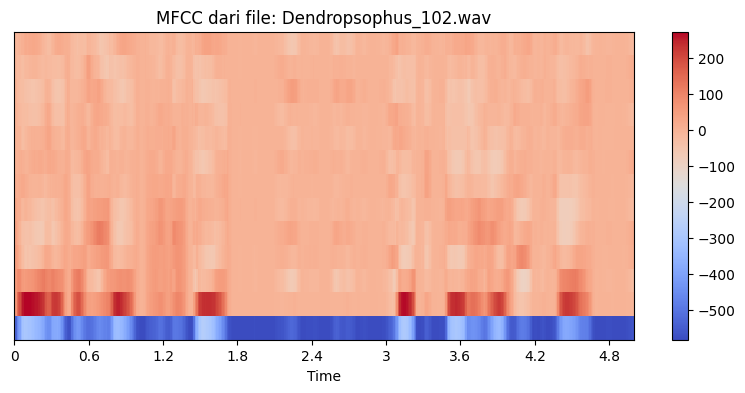

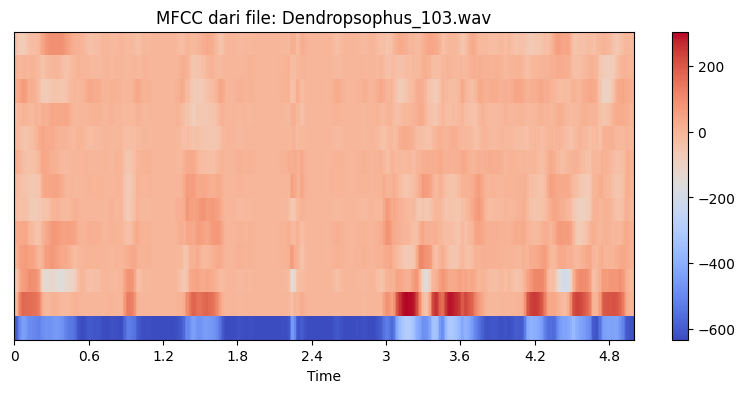

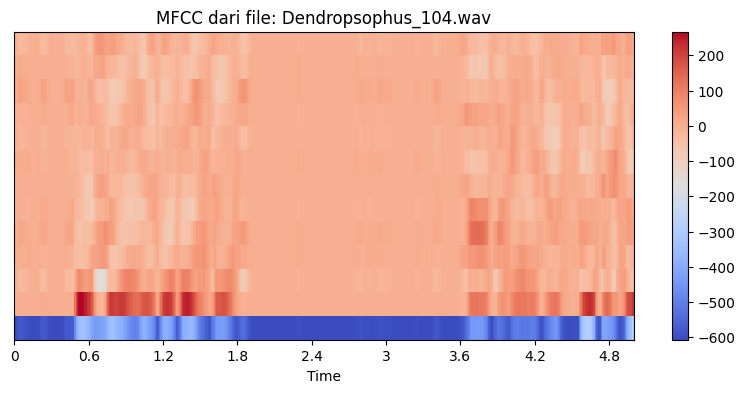

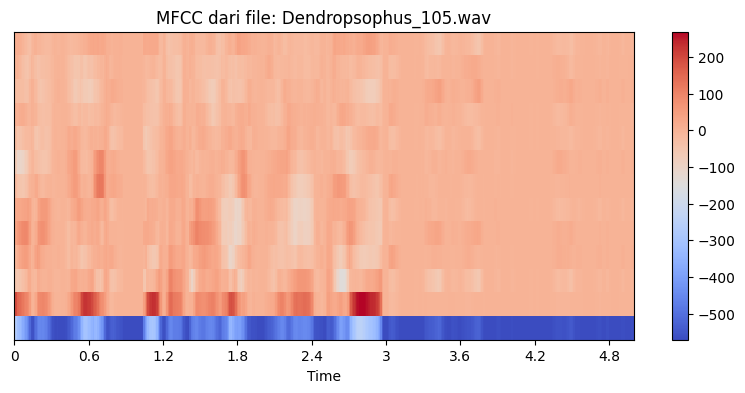

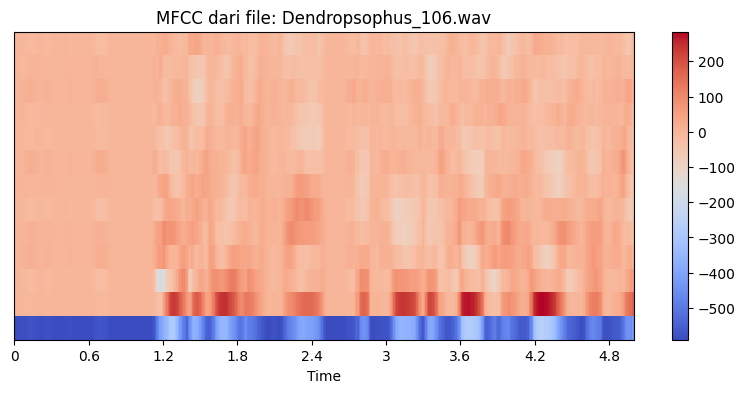

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import os
import glob
import numpy as np

# Path ke folder dataset
folder_path = "/content/drive/MyDrive/TUBES DL/Persiapan Data/Dataset/splitdata_5detik"

# Folder tujuan untuk menyimpan MFCC
mfcc_folder = "/content/drive/MyDrive/TUBES DL/Persiapan Data/Dataset/MFCC"

# Membuat folder jika belum ada
if not os.path.exists(mfcc_folder):
    os.makedirs(mfcc_folder)

# Mengambil semua file .wav dalam folder
audio_files = glob.glob(os.path.join(folder_path, "*.wav"))

# Mengekstrak dan menampilkan MFCC untuk setiap file audio
for file in audio_files:
    # Muat audio
    y, sr = librosa.load(file, sr=None)  # sr=None untuk mempertahankan sample rate asli

    # Ekstraksi MFCC
    mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)  # Ekstraksi 13 koefisien MFCC

    # Menampilkan MFCC
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(mfcc, x_axis='time', sr=sr)
    plt.colorbar()
    plt.title(f"MFCC dari file: {os.path.basename(file)}")
    plt.show()

    # Menyimpan MFCC dalam file .npy
    mfcc_filename = os.path.basename(file).replace(".wav", "_mfcc.npy")
    np.save(os.path.join(mfcc_folder, mfcc_filename), mfcc)  # Menyimpan MFCC

## Cek total mfcc

In [ ]:
import glob
import os

# Path ke folder tempat menyimpan file MFCC (.npy)
mfcc_folder = "/content/drive/MyDrive/TUBES DL/Persiapan Data/Dataset/MFCC"

# Mengambil semua file .npy dalam folder MFCC
mfcc_files = glob.glob(os.path.join(mfcc_folder, "*.npy"))

# Menghitung total file MFCC yang dihasilkan
total_mfcc_files = len(mfcc_files)

# Menampilkan hasil
print(f"Total jumlah file MFCC (.npy) yang dihasilkan: {total_mfcc_files}")

Total jumlah file MFCC (.npy) yang dihasilkan: 1512
